In [ ]:
from google.colab import drive
drive.mount('/content/drive')
path = '/content/drive/My Drive/ecse415/Assignments/a4/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import cv2
import numpy as np
import matplotlib as mpl
from matplotlib import pyplot as plt
from skimage import segmentation, color
from skimage.future import graph
from skimage.segmentation import quickshift
from sklearn import mixture

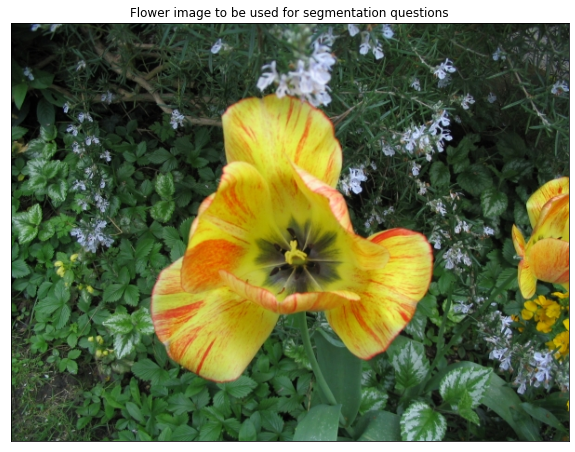

In [ ]:
image_path = path+"flower.jpg"
img = cv2.imread(image_path)
img = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10,10))
plt.subplot(111), plt.imshow(img) 
plt.title("Flower image to be used for segmentation questions"), plt.xticks([]), plt.yticks([])
plt.show()

# Segmentation

## 1.1.1 K-means clustering

In [ ]:
def k_means(img_temp, num_cluster_centers, iter, decision):
    
    # Cluster centers
    ctr = []
    if decision == "rgb":
      h, w, chn = img_temp.shape
    else:
      img_temp = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
      h, w = img_temp.shape
  
    if decision == "rgb":
      [ctr.append(np.random.randint(0,256, chn)) for i in range(num_cluster_centers)] 
    else:
      [ctr.append(np.random.randint(0,256, 1)) for i in range(num_cluster_centers)]
        
    ctr = np.array(ctr)  
        
    for i in range(1,iter+1):
      img_seg = img_temp.copy()
      clusters = []
      for c in range(num_cluster_centers):
        clusters.append([])
      
      for y in range(h):
        for x in range(w):
          if decision == "rgb":
            pos = np.argmin([np.linalg.norm(ctr[j]-img_temp[y,x,:]) for j in range(num_cluster_centers)]) 
          else:
            pos = np.argmin([np.linalg.norm(ctr[j]-img_temp[y,x]) for j in range(num_cluster_centers)])
          clusters[pos].append([y,x])
          if decision == "rgb":
            img_seg[y,x,:] = ctr[pos]
          else:
            img_seg[y,x] = ctr[pos]
      
      if decision == "rgb":
        plt.figure(figsize=(5,5)) 
        plt.imshow(img_seg) 
      else:
        plt.figure(figsize=(5,5))
        plt.imshow(img_seg, cmap="gray")
      if i< iter:
        # Display images during the first 5 iterations
        plt.title("K: {}, Segmentation Number: {}".format(num_cluster_centers,i)) 
      else:
        # Display the final segmentation image
        plt.title("K: {}, Final Segmentation".format(num_cluster_centers))
        plt.show() 
        return img_seg 
          
      # Calculate cluster centers
      for center in range(num_cluster_centers):
        if decision == "rgb":
          if len(clusters[center])== 0:
            continue 
          ctr[center] =[np.average([img[a,b,0] for a,b in clusters[center]]), np.average([img[a,b,1] for a,b in clusters[center]]), np.average([img[a,b,2] for a,b in clusters[center]])] 
        else:
          ctr[center] = np.average([img_temp[a,b] for a,b in clusters[center]])
        ctr = np.array(ctr)

### K = 2

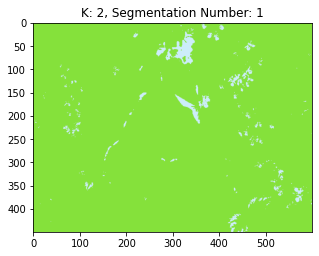

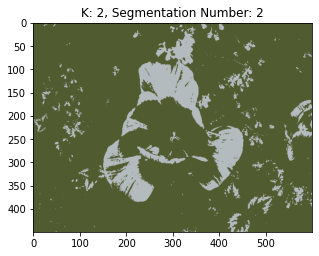

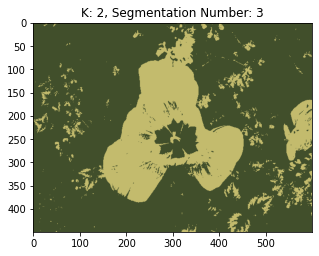

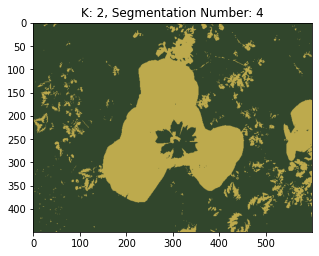

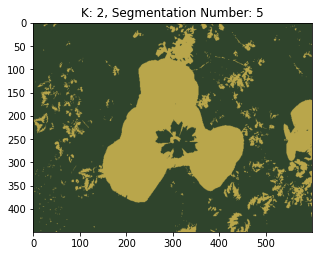

...

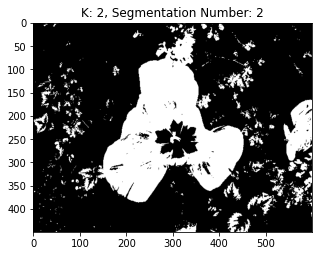

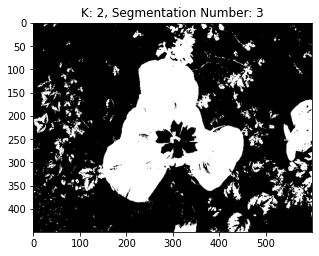

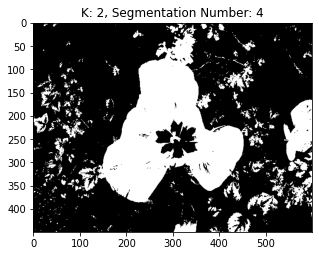

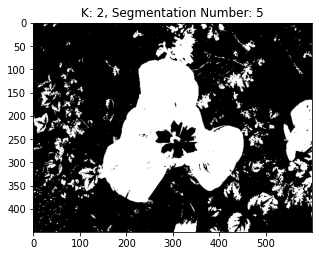

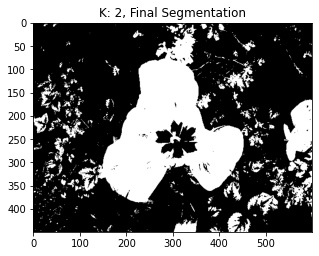

In [ ]:
rgb_k2 = k_means(img, 2,6,"rgb")
gray_k2 = k_means(img, 2,6,"gray")

### K = 3

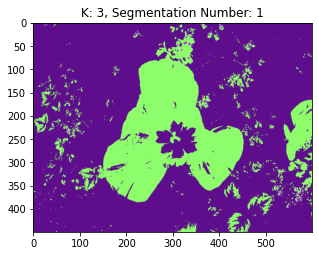

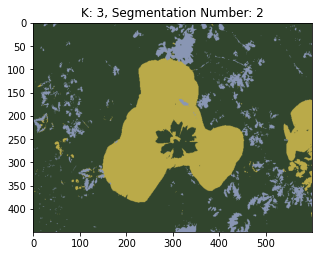

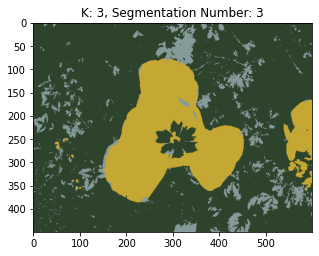

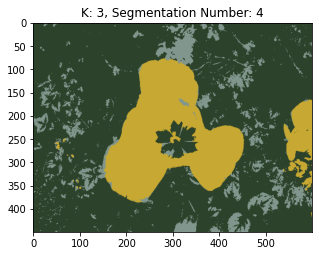

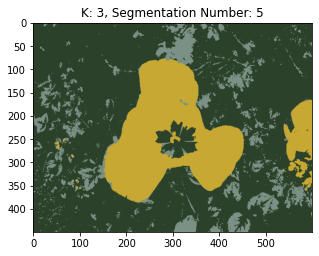

...

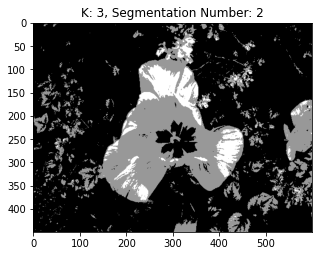

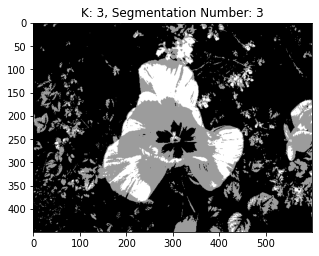

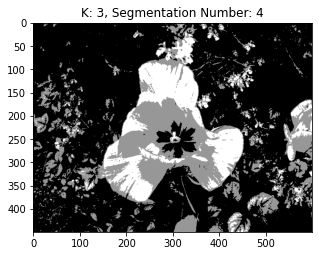

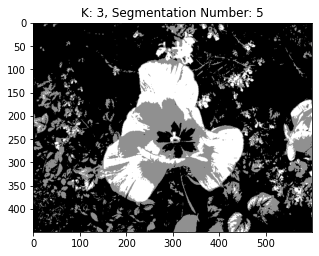

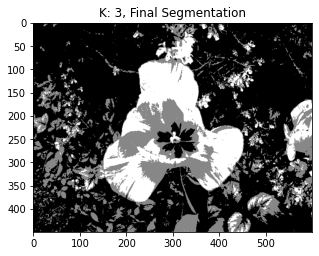

In [ ]:
rgb_k3 = k_means(img, 3,6,"rgb")
gray_k3 = k_means(img, 3,6,"gray")

### Comparison of final segmentation maps of color and gray-scale images

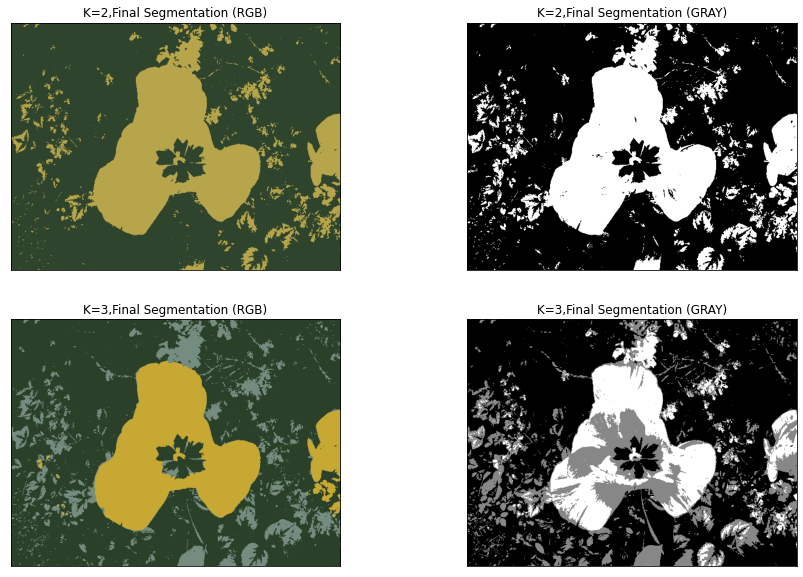

In [ ]:
plt.figure(figsize=(15,10))
plt.subplot(221), plt.imshow(rgb_segmented_img_k2), plt.title("K=2,Final Segmentation (RGB)")
plt.xticks([]),plt.yticks([])
plt.subplot(222), plt.imshow(gray_segmented_img_k2, cmap="gray"), plt.title("K=2,Final Segmentation (GRAY)")
plt.xticks([]),plt.yticks([])
plt.subplot(223), plt.imshow(rgb_segmented_img_k3), plt.title("K=3,Final Segmentation (RGB)")
plt.xticks([]),plt.yticks([])
plt.subplot(224), plt.imshow(gray_segmented_img_k3, cmap="gray"), plt.title("K=3,Final Segmentation (GRAY)")
plt.xticks([]),plt.yticks([])
plt.show()

*   From observing the 4 images above, it is clear that gray-scale images result in better segmentation. The final segmentations in gray-scale are relatively more detailed than the final segmentations in rgb. 
* Not only that, K = 3 in both rgb and gray-scale had better results than K = 2. 
* With K = 3, more of the details of the photo were visible (both in the background, and on the flower). In other words, the differentiation between different pixels in the photo is more obvious. 



## 1.2 Normalized Graph-cut and Mean-shift Segmentation

### Normalized graph-cuts

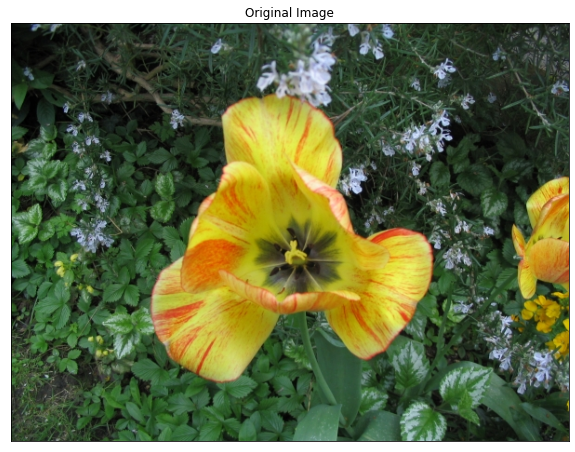

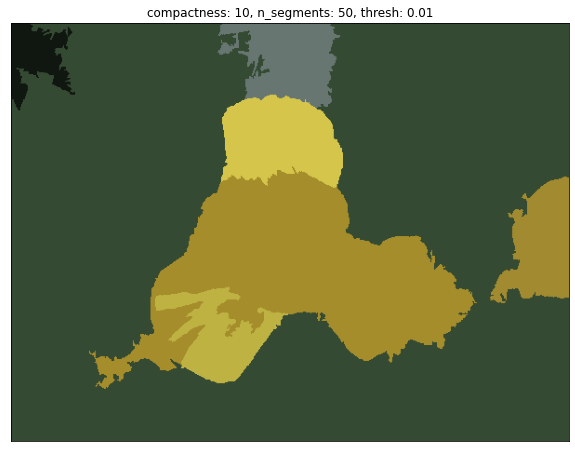

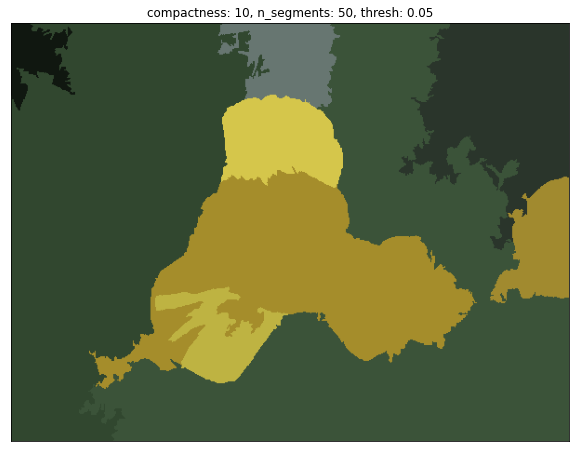

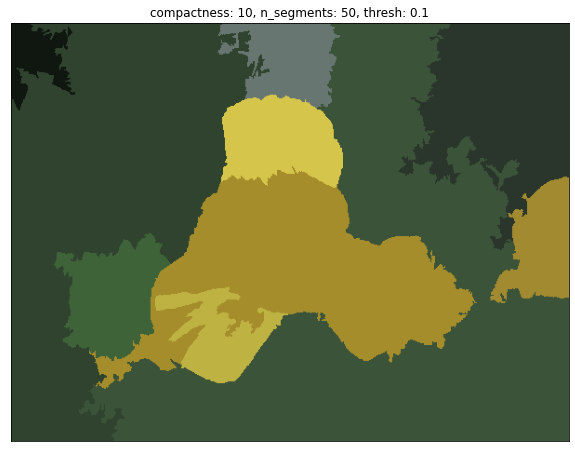

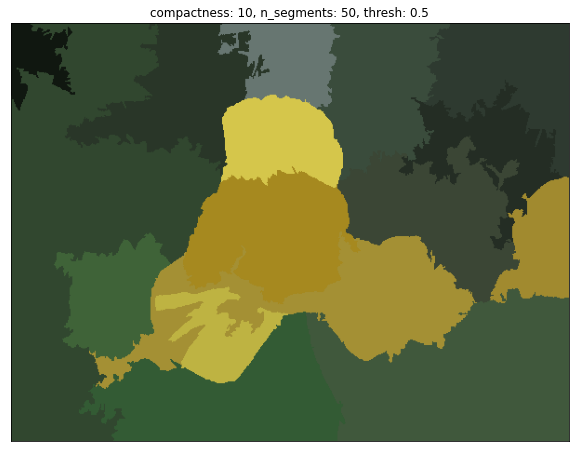

...

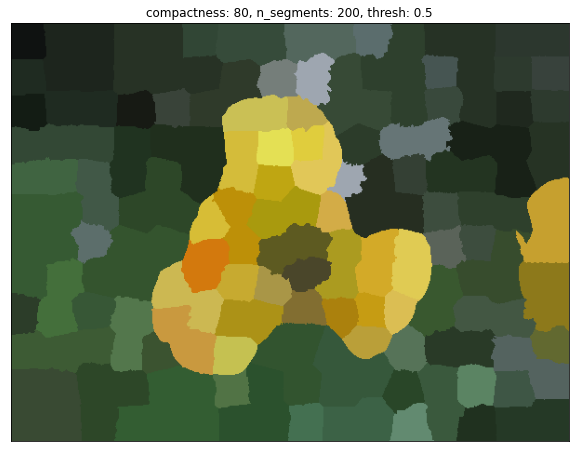

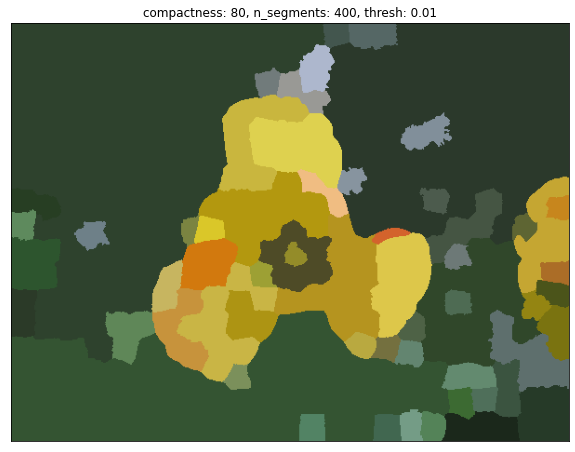

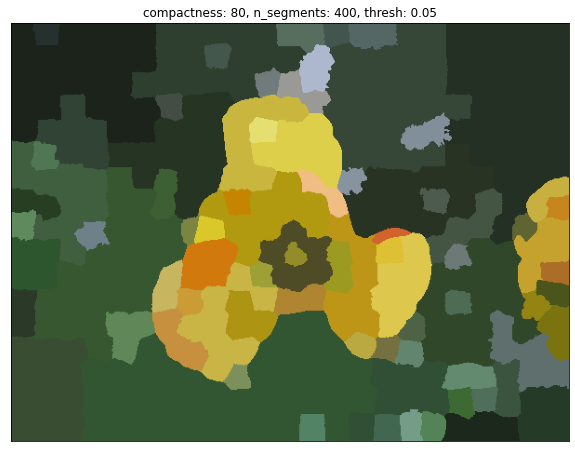

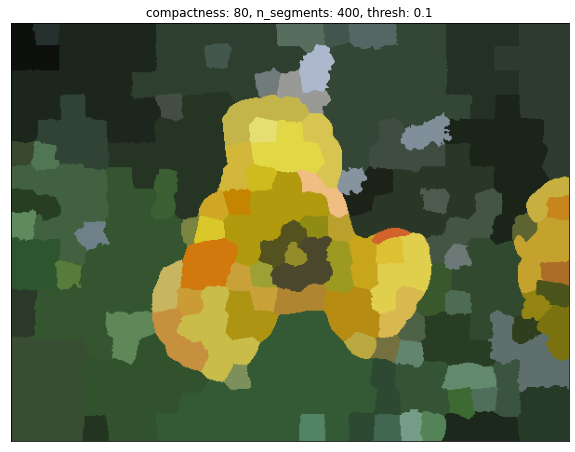

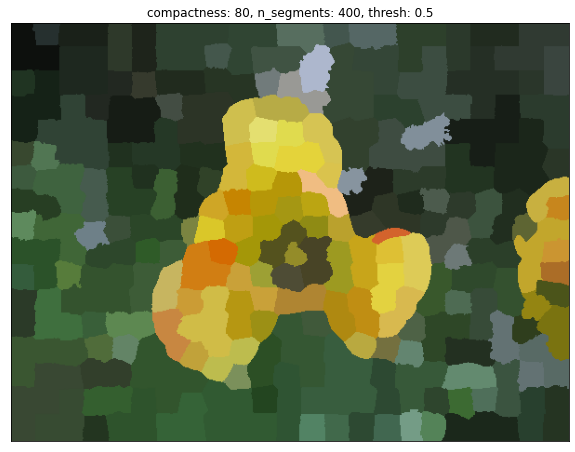

In [ ]:
compactness_list = [10, 20, 40, 80]
n_segments_list  = [50, 100, 200, 400]
thresh_list      = [0.01, 0.05, 0.1, 0.5]

def graph_cut(compactness_temp, n_segments_temp, thresh_temp):

  labels1 = segmentation.slic(img, compactness=compactness_temp, n_segments=n_segments_temp)
  out1 = color.label2rgb(labels1, img, kind="avg")

  g = graph.rag_mean_color(img, labels1, mode='similarity')
  
  labels2 = graph.cut_normalized(labels1, g, thresh=thresh_temp)
  out2 = color.label2rgb(labels2, img, kind='avg')

  plt.figure(figsize=(10,10))
  plt.imshow(out2), plt.title("compactness: {}, n_segments: {}, thresh: {}".format(compactness_temp,n_segments_temp,thresh_temp)) 
  plt.xticks([]) 
  plt.yticks([])
  plt.show()

# display original image
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.title("Original Image")
plt.xticks([]) 
plt.yticks([])

for compactness in compactness_list:
  for n_segments in n_segments_list:
    for thresh in thresh_list:
      graph_cut(compactness,n_segments,thresh)

*   **Increasing thresh while keeping other parameters constant:** Increase in the number of patches in the photo, therefore, the photo became more detailed.
* **Increasing n_segments while keeping other parameters constant:** Increase in the number of patches in the photo, therefore, the photo became more detailed (Just like what happened when we increased thresh while keeping other parameters constant). Furthermore, the range of the possible sizes of the patches increased too. 
* **Increasing compactness while keeping other parameters constant:** This had a different impact compared to what I said above. Increasing the compactness resulted in an increase in the number of patches in the photo, therefore, making the photo more detailed. However, this only occurred up to a specific value of compactness, after which the number of patches in the photo reduced, therefore, making the photo less detailed. 

* **In Summary:** Generally, increasing the value of all three parameters made the photo more detailed. However, increasing compactness after a specific value resulted in making the photo less detailed. 




### Mean-shift

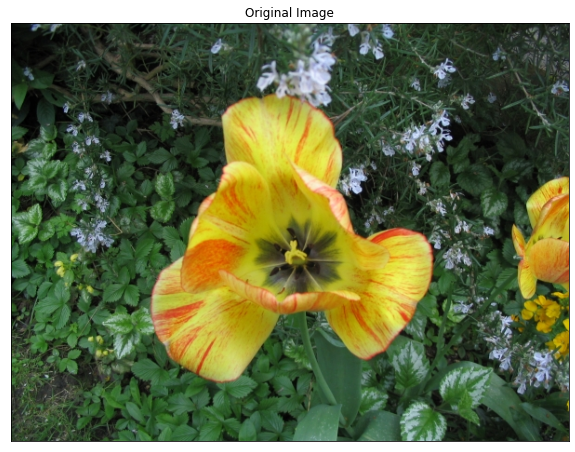

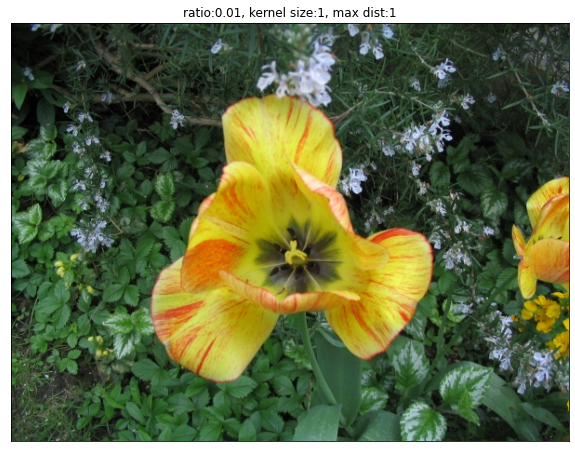

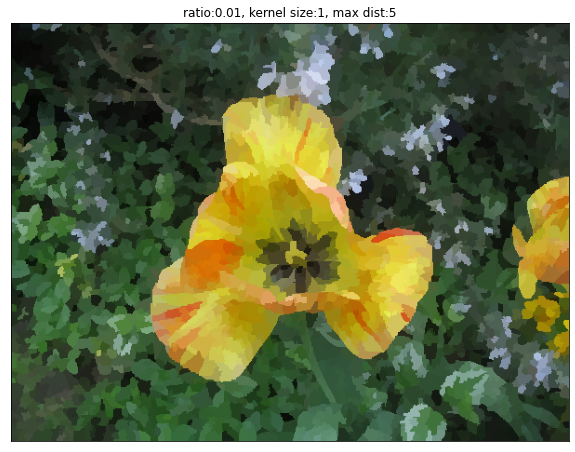

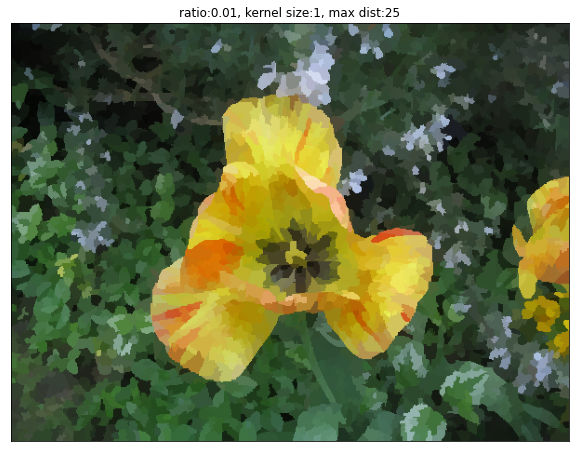

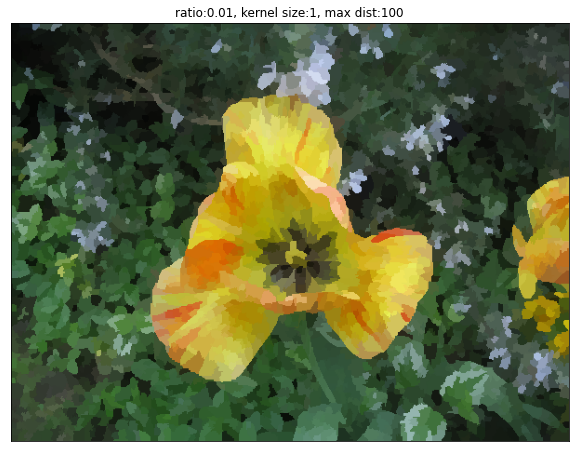

...

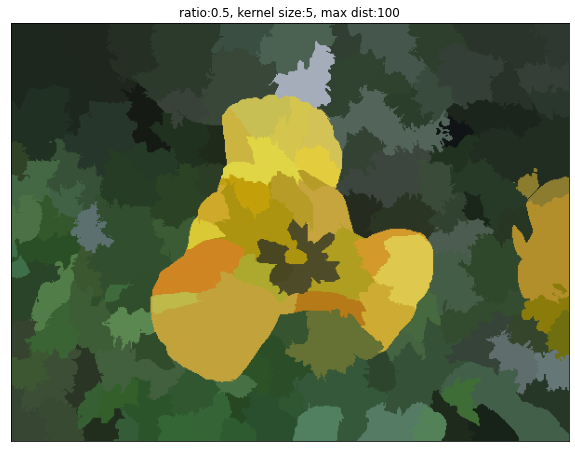

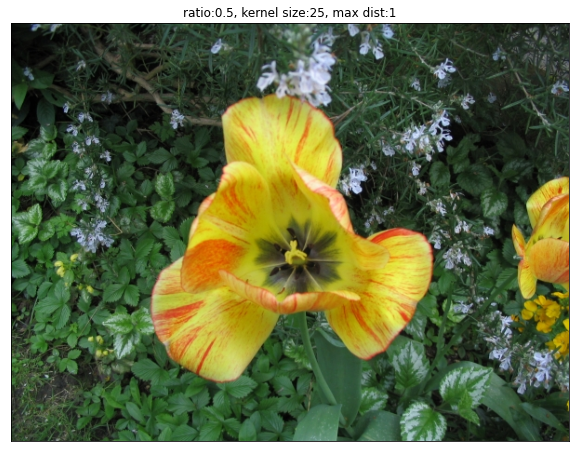

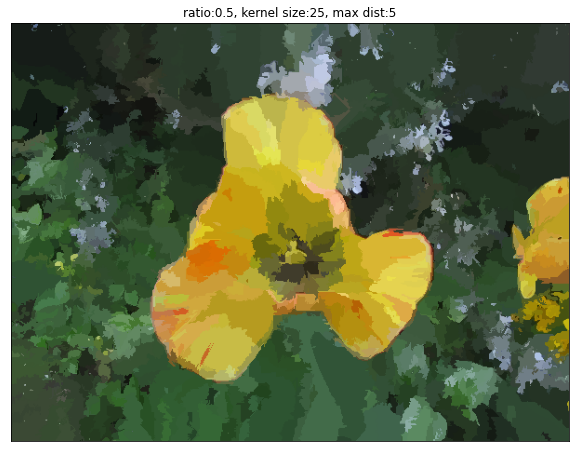

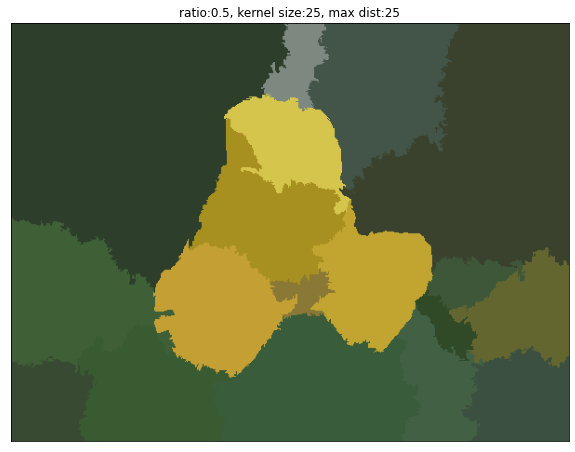

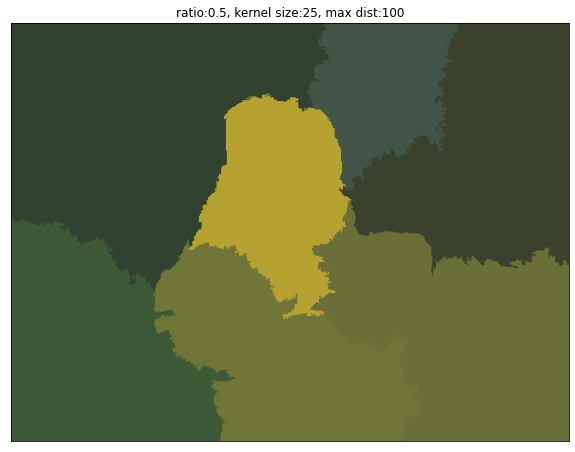

In [ ]:
ratio_list = [0.01, 0.05, 0.1, 0.5] 
kernel_size_list = [1, 5, 25]
max_dist_list = [1, 5, 25, 100] 

def mean_shift(img, ratio_temp, kernel_size_temp, max_dist_temp):

  # apply meanshift
  label = quickshift(img, ratio= ratio_temp, kernel_size= kernel_size_temp, max_dist= max_dist_temp)
  out = color.label2rgb(label, img, kind='avg')

  # display
  plt.figure(figsize=(10,10)), plt.imshow(out)
  plt.title("ratio:{}, kernel size:{}, max dist:{}".format(ratio_temp,kernel_size_temp,max_dist_temp)) 
  plt.xticks([]), plt.yticks([])
  plt.show()

# display original image
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.title("Original Image")
plt.xticks([]) 
plt.yticks([])

for ratio in ratio_list:
  for kernel_size in kernel_size_list:
    for max_dist in max_dist_list:
      mean_shift(img, ratio, kernel_size, max_dist)

*   **Increasing ratio while keeping other parameters constant:** Increase in the number of patches, therefore the image becomes more detailed. Not only that, the variety of the colour of the patches increases as well. 
* **Increasing kernel size while keeping other parameters constant:** Decrease in the number of patches, therefore, image becomes less detailed.
* **Increasing max dist while keeping other parameters constant:** Decrease in the number of patches, therefore, image becomes less detailed.
